In [1]:
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.metrics import mean_squared_error
from sklearn.metrics import accuracy_score

from sklearn.ensemble import RandomForestRegressor

from sklearn.ensemble import GradientBoostingRegressor

import os
os.environ['KMP_DUPLICATE_LIB_OK']='True'
from xgboost import XGBClassifier

import mlflow

import shap

Converting `np.inexact` or `np.floating` to a dtype is deprecated. The current result is `float64` which is not strictly correct.


In [2]:
train = pd.read_csv('train.csv')
test = pd.read_csv('test.csv')

In [3]:
train.shape

(307511, 203)

In [4]:
test.shape

(48744, 202)

## Preprocessing  

In [5]:
X = train.drop('TARGET',axis=1)
y = train['TARGET']

In [6]:
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.2,random_state=43)

In [7]:
min_max_scaler = preprocessing.MinMaxScaler()
X_train = min_max_scaler.fit_transform(X_train)
X_test= min_max_scaler.fit_transform(X_test)

## RandomForest 

In [9]:
rfmodel = RandomForestRegressor()
rfmodel.fit(X_train, y_train)

RandomForestRegressor()

In [10]:
y_pred_rf = rfmodel.predict(X_test)
predictions_rf = [round(value) for value in y_pred_rf]

In [11]:
mse_rf = mean_squared_error(y_test, y_pred_rf)
print('MSE RANDOMFOREST Model : ',mse_rf)

MSE RANDOMFOREST Model :  0.09203478529502628


In [12]:
accuracy = accuracy_score(y_test, predictions_rf)
print("Accuracy: %.2f%%" % (accuracy * 100.0))

Accuracy: 91.63%


## Gradient Boosting 

In [14]:
GB_regressor = GradientBoostingRegressor(max_depth=2,n_estimators=3,learning_rate=1.0)
GB_regressor.fit(X_train, y_train)

GradientBoostingRegressor(learning_rate=1.0, max_depth=2, n_estimators=3)

In [15]:
y_pred_GB = GB_regressor.predict(X_test)
predictions_GB = [round(value) for value in y_pred_GB]

In [16]:
mse_GB = mean_squared_error(y_test, y_pred_GB)
print('MSE XGB Model : ',mse_GB)

MSE XGB Model :  0.07075178145147605


In [17]:
accuracy = accuracy_score(y_test, predictions_GB)
print("Accuracy: %.2f%%" % (accuracy * 100.0))

Accuracy: 91.96%


## XGBOOST

In [8]:
modelXGB = XGBClassifier()
model = modelXGB.fit(X_train, y_train)

In [9]:
# make predictions for test data
y_pred_XGB = modelXGB.predict(X_test)
predictions_XGB = [round(value) for value in y_pred_XGB]

In [10]:
mse_XGB = mean_squared_error(y_test, y_pred_XGB)
print('MSE XGB Model : ',mse_XGB)

MSE XGB Model :  0.08085784433279677


In [11]:
accuracy = accuracy_score(y_test, predictions_XGB)
print("Accuracy: %.2f%%" % (accuracy * 100.0))

Accuracy: 91.91%


## Shap for XGBoost

In [12]:
shap.initjs() 

In [13]:
%%time
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_train)

NPY_ARRAY_UPDATEIFCOPY, NPY_ARRAY_INOUT_ARRAY, and NPY_ARRAY_INOUT_FARRAY are deprecated, use NPY_WRITEBACKIFCOPY, NPY_ARRAY_INOUT_ARRAY2, or NPY_ARRAY_INOUT_FARRAY2 respectively instead, and call PyArray_ResolveWritebackIfCopy before the array is deallocated, i.e. before the last call to Py_DECREF.
UPDATEIFCOPY detected in array_dealloc.  Required call to PyArray_ResolveWritebackIfCopy or PyArray_DiscardWritebackIfCopy is missing


CPU times: user 7min 42s, sys: 2.45 s, total: 7min 45s
Wall time: 2min 20s


In [19]:
explainer.expected_value

-2.5475798

In [14]:
shap.force_plot(explainer.expected_value, shap_values[0], X_train[0], feature_names=list(X.columns.values))

In [20]:
shap.force_plot(explainer.expected_value, shap_values[2], X_train[2], feature_names=list(X.columns.values))

In [15]:
%%time
shap.force_plot(explainer.expected_value, shap_values[::100], X_train[::100], feature_names=list(X.columns.values))

CPU times: user 43 s, sys: 866 ms, total: 43.8 s
Wall time: 46.3 s


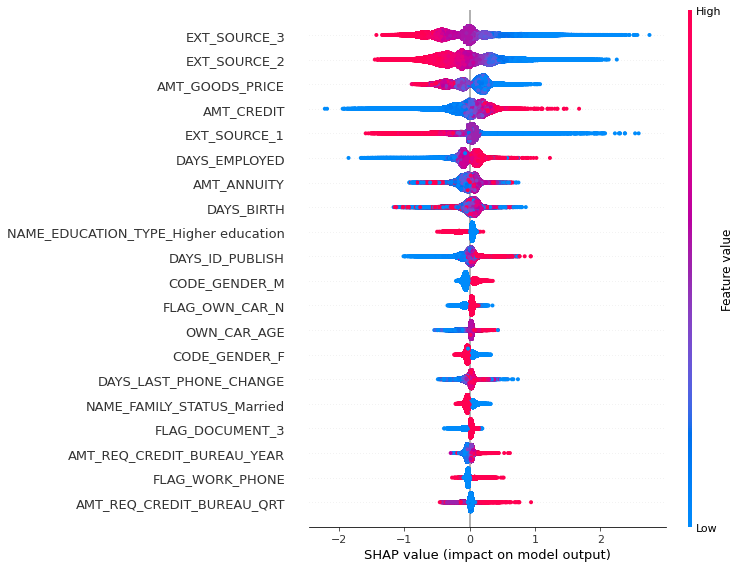

In [15]:
shap.summary_plot(shap_values, X_train, feature_names = list(X.columns.values))

In [21]:
%%time
!python train_GB.py

GBoost model 
  Accuracy: 0.9196299367510528
CPU times: user 463 ms, sys: 153 ms, total: 617 ms
Wall time: 26.1 s


In [22]:
%%time
!python train_xgboost.py

XGBoost model 
  Loss: 2.7781318954464056
  Accuracy: 0.9195648992732062
CPU times: user 4.9 s, sys: 1.44 s, total: 6.34 s
Wall time: 4min 20s


In [23]:
%%time
!python train_RandomForest.py

RandomForest model 
  Accuracy: 0.9196787148594378
CPU times: user 54.3 s, sys: 15.5 s, total: 1min 9s
Wall time: 47min 25s


In [ ]:
!mlflow models serve --model-uri mlruns/0/48181e9af1f9459596f86f00a42e645e/artifacts/model -p 1234

2020/10/28 08:58:08 INFO mlflow.models.cli: Selected backend for flavor 'python_function'
2020/10/28 08:58:09 INFO mlflow.utils.conda: === Creating conda environment mlflow-69e3c77aa1b57f35bcdbf64400882e2f6c4c1d63 ===
/Users/annafischmeister/miniconda3/lib/python3.8/multiprocessing/resource_tracker.py:216: UserWarning: resource_tracker: There appear to be 1 leaked semaphore objects to clean up at shutdown
  warnings.warn('resource_tracker: There appear to be %d '
Solving environment: done


==> WARNING: A newer version of conda exists. <==
  current version: 4.8.3
  latest version: 4.9.1

Please update conda by running

    $ conda update -n base -c defaults conda



mkl-service-2.3.0    | 42 KB     | ##################################### | 100% 
wheel-0.35.1         | 37 KB     | ##################################### | 100% 
numpy-1.19.2         | 21 KB     | ##################################### | 100% 
libedit-3.1.20191231 | 96 KB     | ##################################### | 100% 


2020/10/28 08:59:55 INFO mlflow.pyfunc.backend: === Running command 'source /Users/annafischmeister/miniconda3/bin/../etc/profile.d/conda.sh && conda activate mlflow-69e3c77aa1b57f35bcdbf64400882e2f6c4c1d63 1>&2 && gunicorn --timeout=60 -b 127.0.0.1:1234 -w 1 ${GUNICORN_CMD_ARGS} -- mlflow.pyfunc.scoring_server.wsgi:app'
[2020-10-28 08:59:56 +0100] [9382] [INFO] Starting gunicorn 20.0.4
[2020-10-28 08:59:56 +0100] [9382] [INFO] Listening at: http://127.0.0.1:1234 (9382)
[2020-10-28 08:59:56 +0100] [9382] [INFO] Using worker: sync
[2020-10-28 08:59:56 +0100] [9384] [INFO] Booting worker with pid: 9384
[2020-10-28 09:02:30 +0100] [9382] [CRITICAL] WORKER TIMEOUT (pid:9384)
[2020-10-28 09:02:30 +0100] [9384] [INFO] Worker exiting (pid: 9384)
[2020-10-28 09:02:31 +0100] [9682] [INFO] Booting worker with pid: 9682
